# 1. Packages

In [1]:
# BASE
# ------------------------------------------------------
import numpy as np
import pandas as pd
import os
import gc
import warnings

# PACF - ACF
# ------------------------------------------------------
import statsmodels.api as sm

# DATA VISUALIZATION
# ------------------------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


# CONFIGURATIONS
# ------------------------------------------------------
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')

# 2. Importing data

In [2]:
# Import
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
stores = pd.read_csv("stores.csv")   
transactions = pd.read_csv("transactions.csv").sort_values(["store_nbr", "date"])

In [3]:
train

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0
1,1,2013-01-01,1,BABY CARE,0.00,0
2,2,2013-01-01,1,BEAUTY,0.00,0
3,3,2013-01-01,1,BEVERAGES,0.00,0
4,4,2013-01-01,1,BOOKS,0.00,0
...,...,...,...,...,...,...
3000883,3000883,2017-08-15,9,POULTRY,438.13,0
3000884,3000884,2017-08-15,9,PREPARED FOODS,154.55,1
3000885,3000885,2017-08-15,9,PRODUCE,2419.73,148
3000886,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.00,8


In [4]:
train.dtypes

id               int64
date            object
store_nbr        int64
family          object
sales          float64
onpromotion      int64
dtype: object

In [5]:
test.dtypes

id              int64
date           object
store_nbr       int64
family         object
onpromotion     int64
dtype: object

In [6]:
stores.dtypes

store_nbr     int64
city         object
state        object
type         object
cluster       int64
dtype: object

In [7]:
transactions.dtypes

date            object
store_nbr        int64
transactions     int64
dtype: object

In [8]:
# Datetime
train["date"] = pd.to_datetime(train.date)
test["date"] = pd.to_datetime(test.date)
transactions["date"] = pd.to_datetime(transactions.date)

In [9]:
# Data types
train.onpromotion = train.onpromotion.astype("float16")
test.onpromotion = test.onpromotion.astype("float16")

train.sales = train.sales.astype("float32")

stores.cluster = stores.cluster.astype("int8")

train

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00
1,1,2013-01-01,1,BABY CARE,0.00,0.00
2,2,2013-01-01,1,BEAUTY,0.00,0.00
3,3,2013-01-01,1,BEVERAGES,0.00,0.00
4,4,2013-01-01,1,BOOKS,0.00,0.00
...,...,...,...,...,...,...
3000883,3000883,2017-08-15,9,POULTRY,438.13,0.00
3000884,3000884,2017-08-15,9,PREPARED FOODS,154.55,1.00
3000885,3000885,2017-08-15,9,PRODUCE,2419.73,148.00
3000886,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.00,8.00


# 3. Transactions

In [10]:
transactions

,date,store_nbr,transactions
1,2013-01-02,1,2111
47,2013-01-03,1,1833
93,2013-01-04,1,1863
139,2013-01-05,1,1509
185,2013-01-06,1,520
...,...,...,...
83271,2017-08-11,54,768
83325,2017-08-12,54,903
83379,2017-08-13,54,1054
83433,2017-08-14,54,818


- How well are transactions correlated with sales?

In [11]:
train_store_sales = train.groupby(["date", "store_nbr"]).sales.sum().reset_index().sort_values(by=['store_nbr','date'])
train_store_sales

,date,store_nbr,sales
0,2013-01-01,1,0.00
54,2013-01-02,1,7417.15
108,2013-01-03,1,5873.24
162,2013-01-04,1,5919.88
216,2013-01-05,1,6318.79
...,...,...,...
90719,2017-08-11,54,8513.83
90773,2017-08-12,54,9139.68
90827,2017-08-13,54,14246.83
90881,2017-08-14,54,11882.99


In [12]:
merged_df = pd.merge(train_store_sales, transactions, how='left')
merged_df

,date,store_nbr,sales,transactions
0,2013-01-01,1,0.00,NaN
1,2013-01-02,1,7417.15,2111.00
2,2013-01-03,1,5873.24,1833.00
3,2013-01-04,1,5919.88,1863.00
4,2013-01-05,1,6318.79,1509.00
...,...,...,...,...
90931,2017-08-11,54,8513.83,768.00
90932,2017-08-12,54,9139.68,903.00
90933,2017-08-13,54,14246.83,1054.00
90934,2017-08-14,54,11882.99,818.00


In [13]:
print("Spearman Correlation between Total Sales and Transactions: {:,.4f}".format(merged_df.corr("spearman").sales.loc["transactions"]))
px.scatter(merged_df, x = "transactions", y = "sales", trendline = "ols", trendline_color_override = "red")

Spearman Correlation between Total Sales and Transactions: 0.8175


- So transactions is highly correlated with sales
- Now let's see if there are any patterns in transactions...

In [14]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month
px.box(a, x="year", y="transactions" , color = "month", title = "Transactions")

- All months seem to have similar transaction trends regardless of year
- Let's look at average monthly transactions

In [15]:
avg_monthly_trans = transactions.set_index("date").resample("M").transactions.mean().reset_index()
avg_monthly_trans["year"] = avg_monthly_trans.date.dt.year
px.line(avg_monthly_trans, x='date', y='transactions', color='year',title = "Monthly Average Transactions" )

- This plot makes periodicity of transactions clearer
- Let's aggregate transactions by day of week for each year and see if there's any trend 

In [16]:
temp = transactions.copy()
temp["year"] = temp.date.dt.year
temp["dayofweek"] = temp.date.dt.dayofweek + 1
temp = temp.groupby(["year", "dayofweek"]).transactions.mean().reset_index()

px.line(temp, x="dayofweek", y="transactions" , color = "year", title = "Transactions")

- Looks like there's a clear trend regardless of year

# 4. Oil price

In [17]:
# Import 
oil = pd.read_csv("oil.csv")
oil

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20
...,...,...
1213,2017-08-25,47.65
1214,2017-08-28,46.40
1215,2017-08-29,46.46
1216,2017-08-30,45.96


In [18]:
oil.isnull().sum()

date           0
dcoilwtico    43
dtype: int64

In [19]:
oil.dtypes

date           object
dcoilwtico    float64
dtype: object

In [20]:
# Change date to datetime
oil["date"] = pd.to_datetime(oil.date)

- Oil data seems to be missing entire days and contains nulls as well
- We take care of this by interpolating

In [21]:
# Resample
oil = oil.set_index("date").dcoilwtico.resample("D").sum().reset_index()
oil

,date,dcoilwtico
0,2013-01-01,0.00
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-05,0.00
...,...,...
1699,2017-08-27,0.00
1700,2017-08-28,46.40
1701,2017-08-29,46.46
1702,2017-08-30,45.96


In [22]:
# Interpolate
oil["dcoilwtico"] = np.where(oil["dcoilwtico"] == 0, np.nan, oil["dcoilwtico"])
oil["dcoilwtico_interpolated"] = oil.dcoilwtico.interpolate()
oil

,date,dcoilwtico,dcoilwtico_interpolated
0,2013-01-01,NaN,NaN
1,2013-01-02,93.14,93.14
2,2013-01-03,92.97,92.97
3,2013-01-04,93.12,93.12
4,2013-01-05,NaN,93.15
...,...,...,...
1699,2017-08-27,NaN,46.82
1700,2017-08-28,46.40,46.40
1701,2017-08-29,46.46,46.46
1702,2017-08-30,45.96,45.96


In [23]:
# Plot
p = oil.melt(id_vars=['date']+list(oil.keys()[5:]), var_name='Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x='date', y='value', color='Legend',title = "Daily Oil Price" )

- Let's see if there any correlations between oil price and sales/transactions

Spearman Correlation with Daily Oil Prices
sales          -0.30
transactions    0.04
Name: dcoilwtico_interpolated, dtype: float64 



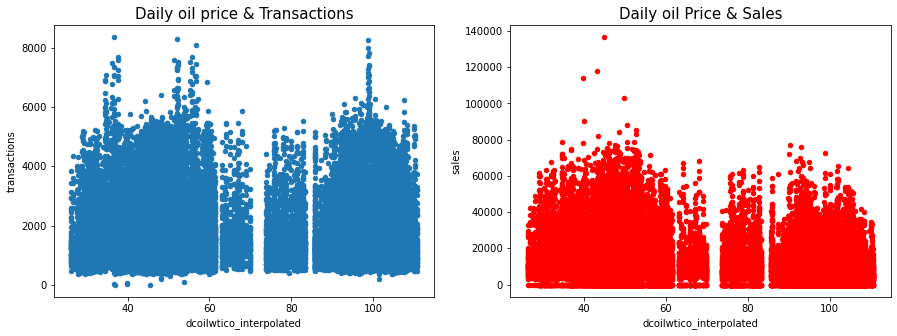

In [24]:
temp = pd.merge(merged_df, oil, how = "left")
print("Spearman Correlation with Daily Oil Prices")
print(temp.drop(["store_nbr", "dcoilwtico"], axis = 1).corr("spearman").dcoilwtico_interpolated.loc[["sales", "transactions"]], "\n")

fig, axes = plt.subplots(1, 2, figsize = (15,5))
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "transactions", ax=axes[0])
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1], color = "r")
axes[0].set_title('Daily oil price & Transactions', fontsize = 15)
axes[1].set_title('Daily oil Price & Sales', fontsize = 15);

- As expected, daily sales are negatively correlated to oil prices (not highly though)
- Transactions and oil prices don't seem to be correlated however
- Let's see if there are any deeper relationships between sales and oil prices
- In particular, we look at correlations between oil prices and sales by product family

In [25]:
a = pd.merge(train.groupby(["date", "family"]).sales.sum().reset_index(), oil.drop("dcoilwtico", axis = 1), how = "left")
c = a.groupby("family").corr("spearman").reset_index()
c = c[c.level_1 == "dcoilwtico_interpolated"][["family", "sales"]].sort_values("sales")
c = c.rename(columns={'sales':'sales_oil_corr'})

c

,family,sales_oil_corr
33,HOME AND KITCHEN II,-0.79
47,MAGAZINES,-0.72
31,HOME AND KITCHEN I,-0.64
63,SCHOOL AND OFFICE SUPPLIES,-0.62
53,PET SUPPLIES,-0.62
3,BABY CARE,-0.62
7,BEVERAGES,-0.61
13,CELEBRATION,-0.61
55,PLAYERS AND ELECTRONICS,-0.58
37,HOME CARE,-0.57


- Almost all families have non-negligible negative correlation with oil price
- Exceptions are HOME APPLIANCES and LINGERIE
- Let's plot oil price vs sales for a handful of product families

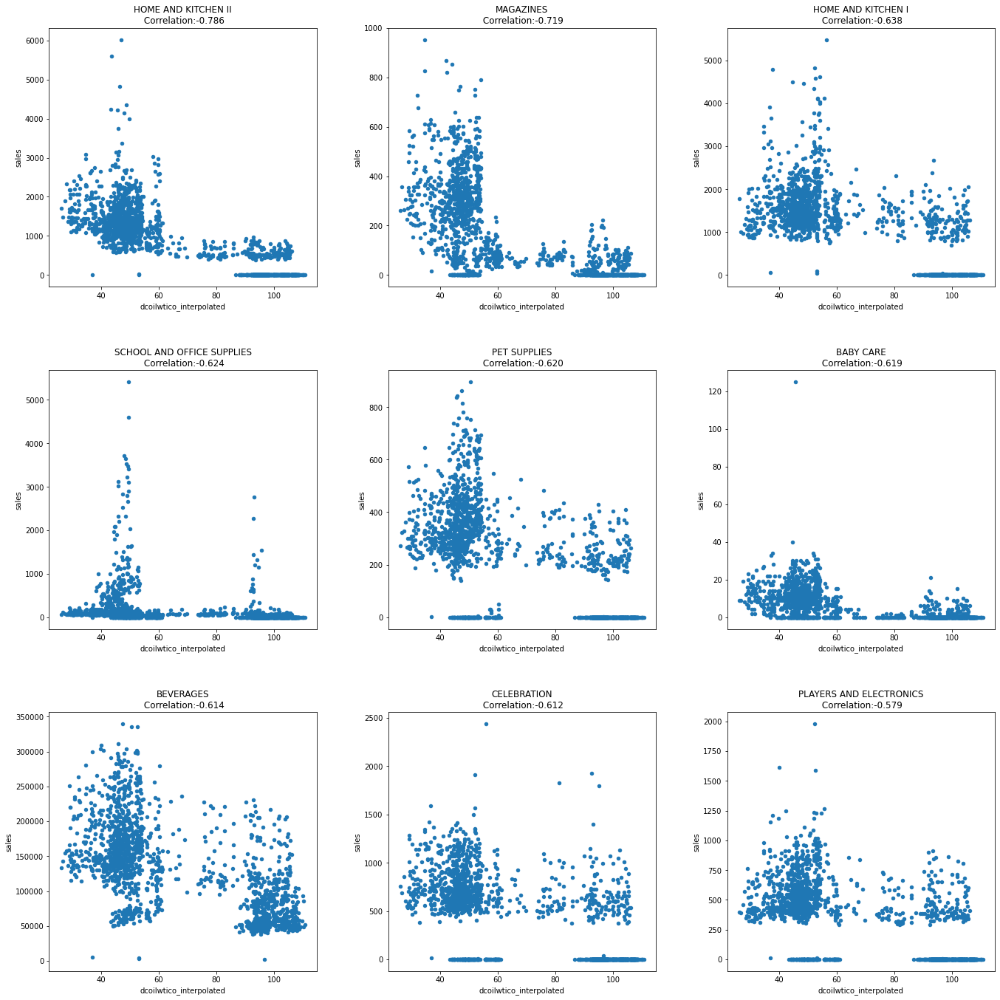

In [26]:
fig, axes = plt.subplots(3, 3, figsize = (20,20))

for i, fam in enumerate(c.family.iloc[0:9]):

    if i < 3:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[0, i])
        axes[0, i].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
    if i >= 3 and i<6:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1, i-3])
        axes[1, i-3].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
    if i >= 6 and i<9:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[2, i-6])
        axes[2, i-6].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
          
plt.tight_layout(pad=5)
plt.show()

- Looking at these plots, it seems there are many more sales when oil price is less than ~ 70
- Let's see if this trend holds up for all families

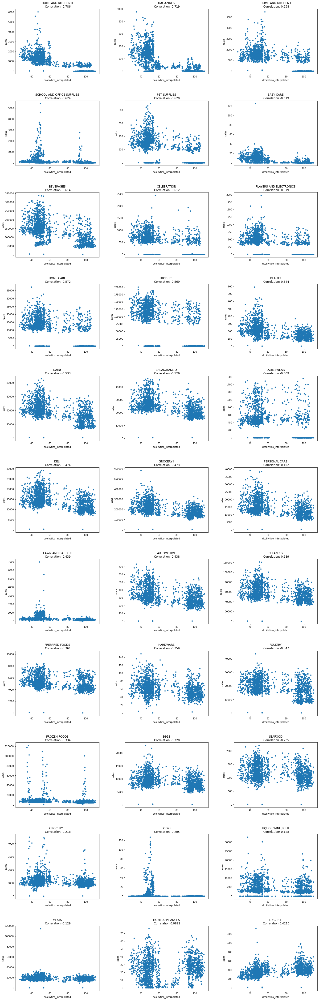

In [27]:
fig, axes = plt.subplots(11, 3, figsize = (20,60))
for i, fam in enumerate(c.family):
    if i < 3:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[0, i])
        axes[0, i].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[0, i].axvline(x=70, color='r', linestyle='--')
    if i >= 3 and i<6:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1, i-3])
        axes[1, i-3].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[1, i-3].axvline(x=70, color='r', linestyle='--')
    if i >= 6 and i<9:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[2, i-6])
        axes[2, i-6].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[2, i-6].axvline(x=70, color='r', linestyle='--')
    if i >= 9 and i<12:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[3, i-9])
        axes[3, i-9].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[3, i-9].axvline(x=70, color='r', linestyle='--')
    if i >= 12 and i<15:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[4, i-12])
        axes[4, i-12].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[4, i-12].axvline(x=70, color='r', linestyle='--')
    if i >= 15 and i < 18:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[5, i-15])
        axes[5, i-15].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[5, i-15].axvline(x=70, color='r', linestyle='--')
    if i >= 18 and i < 21:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[6, i-18])
        axes[6, i-18].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[6, i-18].axvline(x=70, color='r', linestyle='--')
    if i >= 21 and i < 24:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[7, i-21])
        axes[7, i-21].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[7, i-21].axvline(x=70, color='r', linestyle='--')
    if i >= 24 and i < 27:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[8, i-24])
        axes[8, i-24].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[8, i-24].axvline(x=70, color='r', linestyle='--')
    if i >= 27 and i < 30:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[9, i-27])
        axes[9, i-27].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[9, i-27].axvline(x=70, color='r', linestyle='--')
    if i >= 30 :
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[10, i-30])
        axes[10, i-30].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales_oil_corr.iloc[0])[:6], fontsize = 12)
        axes[10, i-30].axvline(x=70, color='r', linestyle='--')
        
        
plt.tight_layout(pad=5)
# plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize = 20);
plt.show()

- It seems the trend holds up

# 5. Sales

- Let's start by looking at how sales among stores are correlated

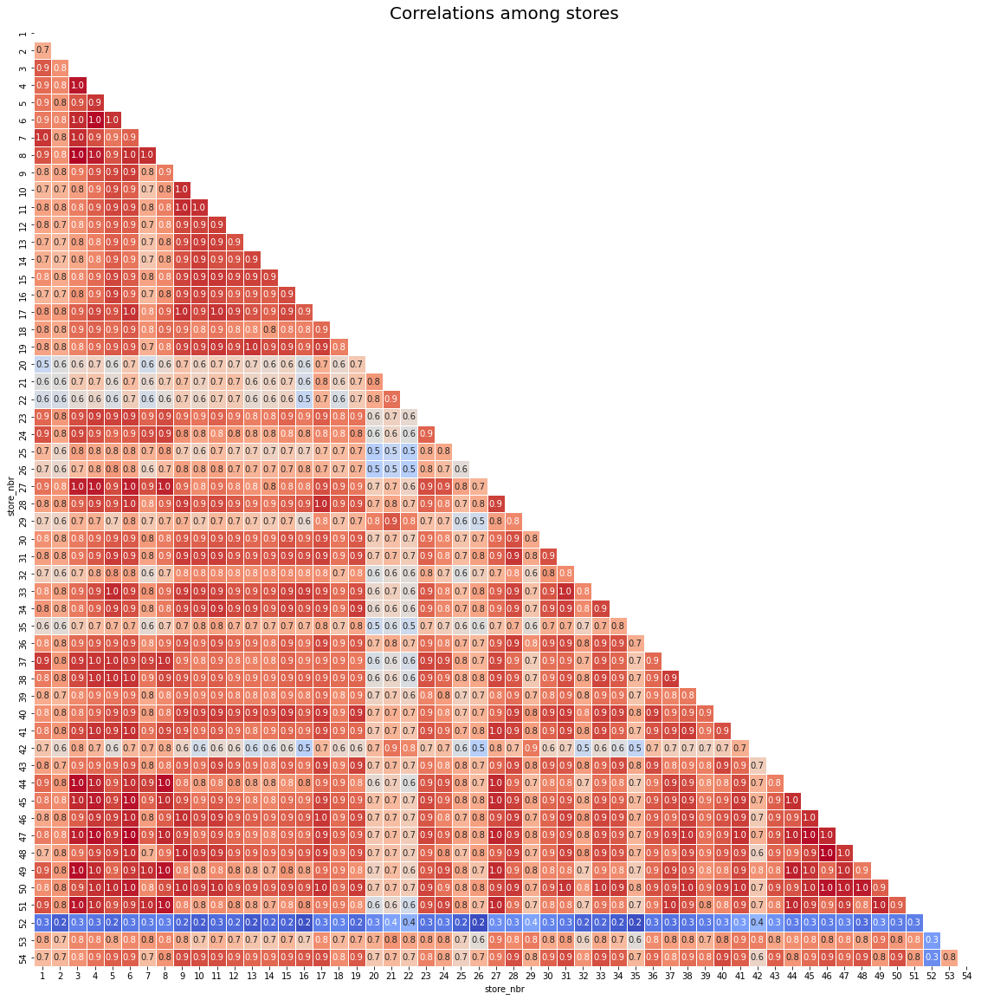

In [28]:
a = train[["store_nbr", "sales"]]
a["ind"] = 1
a["ind"] = a.groupby("store_nbr").ind.cumsum().values
a = pd.pivot(a, index = "ind", columns = "store_nbr", values = "sales").corr()

mask = np.triu(a.corr())
plt.figure(figsize=(20, 20))
sns.heatmap(a,
        annot=True,
        fmt='.1f',
        cmap='coolwarm',
        square=True,
        mask=mask,
        linewidths=1,
        cbar=False)
plt.title("Correlations among stores",fontsize = 20)
plt.show()

- Most stores sales seem highly correlated with one another
- Outliers are stores: 20, 21, 22, 52
- Now let's take a look at total daily sales by store

In [29]:
a = train.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
a

,store_nbr,date,sales
0,1,2013-01-01,0.00
1,1,2013-01-02,7417.15
2,1,2013-01-03,5873.24
3,1,2013-01-04,5919.88
4,1,2013-01-05,6318.79
...,...,...,...
91147,54,2017-08-11,8513.83
91148,54,2017-08-12,9139.68
91149,54,2017-08-13,14246.83
91150,54,2017-08-14,11882.99


- If we look at some stores, we notice they have no sales for many days starting from 2013-01-01, e.g. store_nbr = 20

In [30]:
a = a[a['sales']==0]
a[a['store_nbr']==20].head(50)

,store_nbr,date,sales
32072,20,2013-01-01,0.00
32073,20,2013-01-02,0.00
32074,20,2013-01-03,0.00
32075,20,2013-01-04,0.00
32076,20,2013-01-05,0.00
32077,20,2013-01-06,0.00
32078,20,2013-01-07,0.00
32079,20,2013-01-08,0.00
32080,20,2013-01-09,0.00
32081,20,2013-01-10,0.00


- Other stores that have similar zero sales are store_nbr = 21, 22, 29, 36, 42, 52, 53
- This is likely due to these stores not having opened yet
- We should remove these data points

In [31]:
print(train.shape)

train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]

train.shape

(3000888, 6)


(2780316, 6)

- There are also some stores that don't sell certain families of products

In [32]:
c = train.groupby(["store_nbr", "family"]).sales.sum().reset_index().sort_values(["family","store_nbr"])
c = c[c.sales == 0]
c

,store_nbr,family,sales
1,1,BABY CARE,0.00
397,13,BABY CARE,0.00
727,23,BABY CARE,0.00
1420,44,BABY CARE,0.00
1453,45,BABY CARE,0.00
1486,46,BABY CARE,0.00
1519,47,BABY CARE,0.00
1552,48,BABY CARE,0.00
1585,49,BABY CARE,0.00
1618,50,BABY CARE,0.00


- Let's remove them from dataset
- First though we make new dataframe for store/family combos with no sales
- We will use this for our submission to forecast zero sales

In [33]:
print(train.shape)
# Anti Join
outer_join = train.merge(c[c.sales == 0].drop("sales",axis = 1), how = 'outer', indicator = True)
train = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis = 1)
del outer_join
gc.collect()
train.shape

(2780316, 6)


(2698648, 6)

In [34]:
zero_prediction = []
for i in range(0,len(c)):
    zero_prediction.append(
        pd.DataFrame({
            "date":pd.date_range("2017-08-16", "2017-08-31").tolist(),
            "store_nbr":c.store_nbr.iloc[i],
            "family":c.family.iloc[i],
            "sales":0
        })
    )
zero_prediction = pd.concat(zero_prediction)
del c
gc.collect()
zero_prediction

,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


- Now let's examine how frequently product families for certain stores have zero/non-zero sales
- To get a sense of things, we look at last 60 days of sales

In [35]:
window = 60
c = train.groupby(["family", "store_nbr"]).tail(window).groupby(["family", "store_nbr"]).sales.sum().reset_index()
c[c.sales == 0]

,family,store_nbr,sales
54,BABY CARE,2,0.00
62,BABY CARE,10,0.00
64,BABY CARE,12,0.00
65,BABY CARE,14,0.00
76,BABY CARE,26,0.00
82,BABY CARE,32,0.00
83,BABY CARE,33,0.00
87,BABY CARE,37,0.00
88,BABY CARE,38,0.00
92,BABY CARE,42,0.00


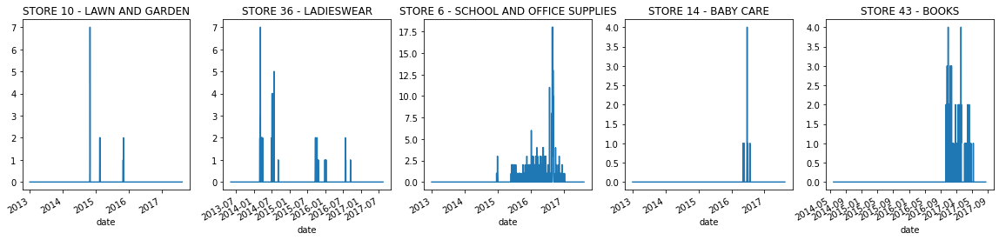

In [36]:
fig, ax = plt.subplots(1,5, figsize = (20,4))
train[(train.store_nbr == 10) & (train.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
train[(train.store_nbr == 36) & (train.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
train[(train.store_nbr == 6) & (train.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
train[(train.store_nbr == 14) & (train.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 14 - BABY CARE")
train[(train.store_nbr == 53) & (train.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 43 - BOOKS")
plt.show()

- We might want to engineer feature based on how active/passive these family/store combos are
- Let's also investigate trends/seasonality/anomalies for product family sales

In [37]:
a = train.set_index("date").groupby("family").resample("D").sales.sum().reset_index()
fig = px.line(a, x = "date", y= "sales", color = "family", title = "Daily total sales of the family")

countries_to_hide = train.family.unique()
fig.for_each_trace(lambda trace: trace.update(visible="legendonly") 
                   if trace.name in countries_to_hide else ())
fig.show()

- We can see trend in family like BEAUTY
- We can see seasonality in family like SCHOOL AND OFFICE SUPPLIES
- We can see anomaly in family like BABY CARE
- Let's now look at which families have the highest total sales

In [38]:
a = train.groupby("family").sales.sum().sort_values(ascending = False).reset_index()
px.bar(a, y = "family", x="sales", color = "family")

- Let's look at correlation between sales and onpromotion

In [39]:
print("Spearman Correlation between Sales and Onpromotion: {:,.4f}".format(train.corr("spearman").sales.loc["onpromotion"]))

Spearman Correlation between Sales and Onpromotion: 0.5304


- Finally, let's look at sales by store

In [40]:
d = pd.merge(train, stores)
d["store_nbr"] = d["store_nbr"].astype("int8")
d["year"] = d.date.dt.year
px.line(d.groupby(["city", "year"]).sales.mean().reset_index(), x = "year", y = "sales", color = "city")

# 6. Holidays and events

In [42]:
holidays = pd.read_csv("holidays_events.csv")
holidays["date"] = pd.to_datetime(holidays.date)

holidays

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False
...,...,...,...,...,...,...
345,2017-12-22,Additional,National,Ecuador,Navidad-3,False
346,2017-12-23,Additional,National,Ecuador,Navidad-2,False
347,2017-12-24,Additional,National,Ecuador,Navidad-1,False
348,2017-12-25,Holiday,National,Ecuador,Navidad,False
